In [1]:
import numpy as np
import sys
sys.path.insert(1,'/home/zhanibek/.local/lib/python2.7/site-packages/cv2')
sys.path.insert(1,'/home/zhanibek/catkin_ws/src/smart_tray/scripts/')
import cv2 
import matplotlib.pyplot as plt
import os
from tqdm import tqdm_notebook
import pickle
import pandas as pd
from phri.utils import *
import platform
print(platform.python_version())

2.7.12


In [18]:
import plotly as py
import plotly.graph_objs as go
import ipywidgets as widgets


In [56]:
%matplotlib inline
# %matplotlib widget
# %matplotlib nbagg

# %matplotlib notebook

### Functions

In [3]:
x = np.nan

### Constants

In [155]:
meta_data_paths = [
'/home/zhanibek/catkin_ws/src/smart_tray/data/rosbag/koh_sanket/trial_0/koh_sanket_trial_0_2020-10-11-20-48-27_meta_data_aruco_offline.pkl',
'/home/zhanibek/catkin_ws/src/smart_tray/data/rosbag/koh_zhanibek/trial_0/koh_zhanibek_trial_0_2020-10-11-21-19-07_meta_data_aruco_offline.pkl',
'/home/zhanibek/catkin_ws/src/smart_tray/data/rosbag/sanket_vignesh/trial_0/trial_0_2020-10-12-14-47-43_meta_data_aruco_offline.pkl',
'/home/zhanibek/catkin_ws/src/smart_tray/data/rosbag/sanket_vignesh/trial_1/trial_1_2020-10-12-14-51-53_meta_data_aruco_offline.pkl',
'/home/zhanibek/catkin_ws/src/smart_tray/data/rosbag/zhanibek_sanket/trial_0/trial_0_2020-10-12-15-02-32_meta_data_aruco_offline.pkl',
'/home/zhanibek/catkin_ws/src/smart_tray/data/rosbag/zhanibek_vignesh/trial_0/trial_0_2020-10-12-14-57-11_meta_data_aruco_offline.pkl'
]

meta_data_path = meta_data_paths[1]

In [156]:
imu_delay = 52345.383253

In [157]:
meta_data = pickle.load(open(meta_data_path))

In [158]:
keys = meta_data.keys()
keys.sort()
keys

['/RFT_FORCE',
 '/RFT_FORCE_2',
 '/cam1_tray_grf',
 '/cam1_tray_pose_estimation',
 '/cam2_tray_grf',
 '/cam2_tray_pose_estimation',
 '/cam3_tray_grf',
 '/cam3_tray_pose_estimation',
 '/imu_data',
 'camera_1',
 'camera_1_grf_offline',
 'camera_1_raw_pose_offline',
 'camera_2',
 'camera_2_grf_offline',
 'camera_2_raw_pose_offline',
 'camera_3',
 'camera_3_grf_offline',
 'camera_3_raw_pose_offline',
 'summary']

In [159]:
summary = meta_data['summary']
cam1_df = meta_data['camera_1']
cam2_df = meta_data['camera_2']
cam3_df = meta_data['camera_3']

rft1_df = meta_data['/RFT_FORCE']
rft2_df = meta_data['/RFT_FORCE_2']

imu_df = meta_data['/imu_data']

pose1_df = meta_data['/cam1_tray_pose_estimation']
pose2_df = meta_data['/cam2_tray_pose_estimation']
pose3_df = meta_data['/cam3_tray_pose_estimation']

pose1_off_df = meta_data['camera_1_raw_pose_offline']
pose2_off_df = meta_data['camera_2_raw_pose_offline']
pose3_off_df = meta_data['camera_3_raw_pose_offline']

grf1_df = meta_data['/cam1_tray_grf']
grf2_df = meta_data['/cam2_tray_grf']
grf3_df = meta_data['/cam3_tray_grf']

grf1_off_df = meta_data['camera_1_grf_offline']
grf2_off_df = meta_data['camera_2_grf_offline']
grf3_off_df = meta_data['camera_3_grf_offline']



### Summary

In [160]:
summary

,topic_name,message_count,frequency,msg_type,start_time,end_time
0,/cam1_tray_pose_estimation,5622,14.617712,geometry_msgs/PoseStamped,1.602469e+09,1.602470e+09
1,/cam2_tray_grf,4540,28.888381,geometry_msgs/PoseStamped,1.602469e+09,1.602470e+09
2,/cam2_tray_pose_estimation,11504,30.552914,geometry_msgs/PoseStamped,1.602469e+09,1.602470e+09
3,/cam3_tray_pose_estimation,11642,30.051831,geometry_msgs/PoseStamped,1.602469e+09,1.602470e+09
4,/cam1_tray_grf,4407,14.521579,geometry_msgs/PoseStamped,1.602469e+09,1.602470e+09
5,/RFT_FORCE_2,319274,1007.035774,geometry_msgs/WrenchStamped,1.602469e+09,1.602470e+09
6,/RFT_FORCE,317969,1007.277618,geometry_msgs/WrenchStamped,1.602469e+09,1.602470e+09
7,/imu_data,29999,77.267358,smart_tray/imu_msg,1.602469e+09,1.602470e+09
8,/cam3_tray_grf,6021,29.849723,geometry_msgs/PoseStamped,1.602469e+09,1.602470e+09
9,/camera_1,3107,8.090996,sensor_msgs/Image,NaN,NaN


In [161]:
t0 = summary.start_time[0]
tf = summary.end_time[0]
print t0, tf
print tf-t0

1602469147.2679124 1602469535.344002
388.0760896205902


In [162]:
pose1_off_df.tail()

,seq,time_stamp,frame_id,position,quaternion
3102,103355,1.602470e+09,angetube_103354_offline,"[1.292120479213461, 0.3034704309170368, 2.8148...","[0.6169217461754446, -0.6046340205791045, 0.37..."
3103,103356,1.602470e+09,angetube_103355_offline,"[1.292120479213461, 0.3034704309170368, 2.8148...","[0.6188651255996965, -0.6031198599687588, 0.37..."
3104,103357,1.602470e+09,angetube_103356_offline,"[1.292120479213461, 0.3034704309170368, 2.8148...","[0.618886892704858, -0.6031700041768546, 0.375..."
3105,103383,1.602470e+09,angetube_103382_offline,"[1.292120479213461, 0.3034704309170368, 2.8148...","[0.6190783852814328, -0.6010379683108782, 0.37..."
3106,103384,1.602470e+09,angetube_103383_offline,"[1.292120479213461, 0.3034704309170368, 2.8148...","[0.6186829519771357, -0.6020061974704213, 0.37..."


In [163]:
cam1_df.dtypes

seq             int64
time_stamp    float64
frame_id       object
image_path     object
dtype: object

In [164]:
imname = cam1_df.image_path[0]

In [165]:
pose1_df.head()

,seq,time_stamp,frame_id,position,quaternion
0,58219,1.602469e+09,angetube_90610,"[1.112229153782468, 0.30615104812651, 3.073038...","[-0.01643102200245661, -0.5053906345968522, 0...."
1,58220,1.602469e+09,angetube_90611,"[1.1151701223354613, 0.3071181363231013, 3.081...","[-0.016867885552682548, -0.5053564134640706, 0..."
2,58221,1.602469e+09,angetube_90612,"[1.1346331394488771, 0.31259046113471073, 3.12...","[-0.0063138336578268265, -0.5047547019702432, ..."
3,58222,1.602469e+09,angetube_90613,"[1.1097284149779716, 0.30345929061577026, 3.06...","[-0.01613569437560635, -0.5092776985317796, 0...."
4,58223,1.602469e+09,angetube_90614,"[1.1180027256555594, 0.3062062253956034, 3.085...","[-0.014955448188818015, -0.5097072150515206, 0..."


In [166]:
grf1_df.head()

,seq,time_stamp,frame_id,position,quaternion
0,49098,1.602469e+09,GRF repr,"[1.221593188300968, 0.21691529404164855, -0.11...","[0.3993177154958203, 0.3613835993087891, 0.815..."
1,49099,1.602469e+09,GRF repr,"[1.2252693555190086, 0.22389363313943011, -0.1...","[0.4005106236374804, 0.36044857586539847, 0.81..."
2,49100,1.602469e+09,GRF repr,"[1.2482555023484438, 0.25676033016793465, -0.1...","[0.4055781699139802, 0.36106266113628677, 0.81..."
3,49101,1.602469e+09,GRF repr,"[1.218548775907228, 0.21261759871270813, -0.10...","[0.4009092157408487, 0.3559222200912138, 0.816..."
4,49102,1.602469e+09,GRF repr,"[1.228430440777354, 0.22752883619586584, -0.11...","[0.4008202715320778, 0.3558843885763445, 0.817..."


### Camera 1

In [167]:
cam1_df.head()

,seq,time_stamp,frame_id,image_path
0,90747,1.602469e+09,angetube_90746,/home/zhanibek/catkin_ws/src/smart_tray/data/r...
1,90748,1.602469e+09,angetube_90747,/home/zhanibek/catkin_ws/src/smart_tray/data/r...
2,90749,1.602469e+09,angetube_90748,/home/zhanibek/catkin_ws/src/smart_tray/data/r...
3,90750,1.602469e+09,angetube_90749,/home/zhanibek/catkin_ws/src/smart_tray/data/r...
4,90751,1.602469e+09,angetube_90750,/home/zhanibek/catkin_ws/src/smart_tray/data/r...


In [168]:
cam2_df.head()

,seq,time_stamp,frame_id,image_path
0,67727,1.602469e+09,logitech_t1_67726,/home/zhanibek/catkin_ws/src/smart_tray/data/r...
1,67728,1.602469e+09,logitech_t1_67727,/home/zhanibek/catkin_ws/src/smart_tray/data/r...
2,67729,1.602469e+09,logitech_t1_67728,/home/zhanibek/catkin_ws/src/smart_tray/data/r...
3,67730,1.602469e+09,logitech_t1_67729,/home/zhanibek/catkin_ws/src/smart_tray/data/r...
4,67731,1.602469e+09,logitech_t1_67730,/home/zhanibek/catkin_ws/src/smart_tray/data/r...


In [169]:
cam3_df.head()

,seq,time_stamp,frame_id,image_path
0,67911,1.602469e+09,logitech_t2_67910,/home/zhanibek/catkin_ws/src/smart_tray/data/r...
1,67912,1.602469e+09,logitech_t2_67911,/home/zhanibek/catkin_ws/src/smart_tray/data/r...
2,67913,1.602469e+09,logitech_t2_67912,/home/zhanibek/catkin_ws/src/smart_tray/data/r...
3,67914,1.602469e+09,logitech_t2_67913,/home/zhanibek/catkin_ws/src/smart_tray/data/r...
4,67915,1.602469e+09,logitech_t2_67914,/home/zhanibek/catkin_ws/src/smart_tray/data/r...


1432


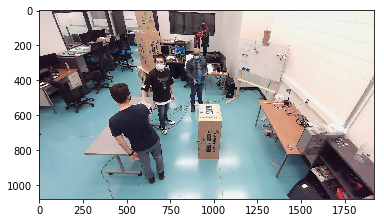

In [170]:
df = cam1_df
ind = np.random.randint(df.shape[0])
impath = df.image_path.iloc[ind]
im = read_image(impath)
plt.imshow(im)
print ind

## Force Data

In [171]:
rft1_df.head()

,seq,time_stamp,frame_id,force,torque
0,1989598,1.602469e+09,C00300122,"[-0.07999999821186066, 0.03999999910593033, -0...","[-0.001500000013038516, 0.03999999910593033, -..."
1,1989599,1.602469e+09,C00300122,"[-0.05999999865889549, 0.03999999910593033, -0...","[-0.001500000013038516, 0.03999999910593033, -..."
2,1989600,1.602469e+09,C00300122,"[-0.05999999865889549, 0.03999999910593033, -0...","[-0.0010000000474974513, 0.03999999910593033, ..."
3,1989601,1.602469e+09,C00300122,"[-0.03999999910593033, 0.05999999865889549, -0...","[-0.0005000000237487257, 0.05999999865889549, ..."
4,1989602,1.602469e+09,C00300122,"[-0.019999999552965164, 0.05999999865889549, -...","[0.0, 0.05999999865889549, -0.2800000011920929]"


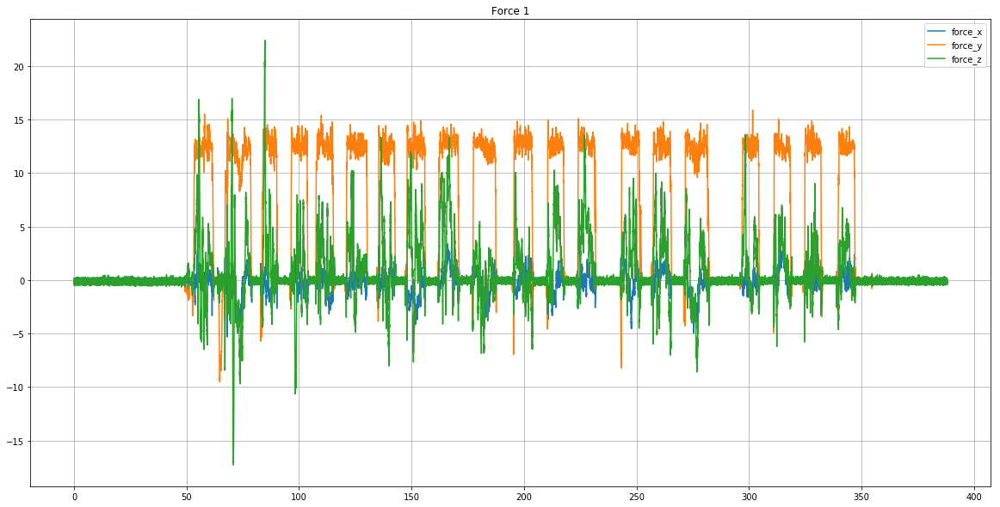

In [172]:
df = rft1_df
force1_x = df.force.apply(lambda x: x[0])
force1_y = df.force.apply(lambda x: x[1])
force1_z = df.force.apply(lambda x: x[2])

rft1_t_vec = df.time_stamp-t0

plt.figure(figsize=(20,10))
plt.plot(rft1_t_vec, force1_x)
plt.plot(rft1_t_vec, force1_y)
plt.plot(rft1_t_vec, force1_z)
plt.grid()
plt.legend(['force_x', 'force_y', 'force_z'])
plt.title('Force 1')
plt.show()

Text(0.5,1,'Force 1')

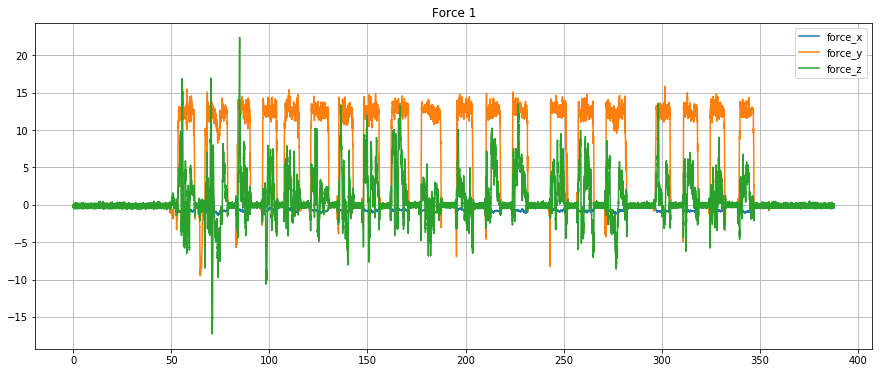

In [173]:
df = rft1_df
torque1_x = df.torque.apply(lambda x: x[0])
torque1_y = df.torque.apply(lambda x: x[1])
torque1_z = df.torque.apply(lambda x: x[2])

rft1_t_vec = df.time_stamp-t0

plt.figure(figsize=(15,6))
plt.plot(rft1_t_vec, torque1_x)
plt.plot(rft1_t_vec, torque1_y)
plt.plot(rft1_t_vec, force1_z)
plt.grid()
plt.legend(['force_x', 'force_y', 'force_z'])
plt.title('Force 1')

In [174]:
rft2_df.head()

,seq,time_stamp,frame_id,force,torque
0,1987772,1.602469e+09,C00300119,"[-0.019999999552965164, -0.05999999865889549, ...","[0.0005000000237487257, -0.05999999865889549, ..."
1,1987773,1.602469e+09,C00300119,"[-0.03999999910593033, -0.05999999865889549, -...","[0.0005000000237487257, -0.05999999865889549, ..."
2,1987774,1.602469e+09,C00300119,"[-0.019999999552965164, -0.03999999910593033, ...","[0.0005000000237487257, -0.03999999910593033, ..."
3,1987775,1.602469e+09,C00300119,"[-0.019999999552965164, -0.019999999552965164,...","[0.0005000000237487257, -0.019999999552965164,..."
4,1987776,1.602469e+09,C00300119,"[0.0, -0.019999999552965164, -0.10000000149011...","[0.0, -0.019999999552965164, -0.10000000149011..."


Text(0.5,1,'Force 2')

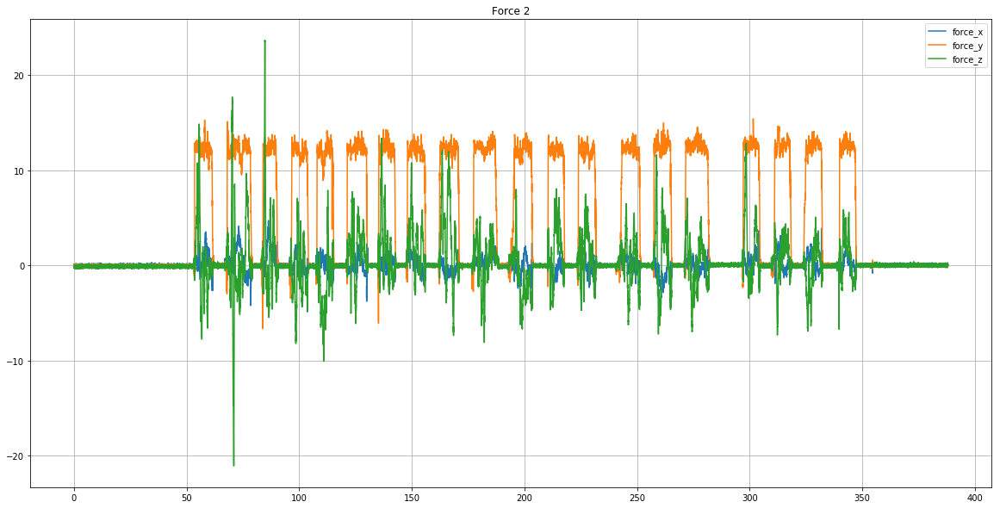

In [175]:
df = rft2_df
force2_x = df.force.apply(lambda x: x[0])
force2_y = df.force.apply(lambda x: x[1])
force2_z = df.force.apply(lambda x: x[2])

rft2_t_vec = df.time_stamp-t0

plt.figure(figsize=(20,10))
plt.plot(rft2_t_vec, force2_x)
plt.plot(rft2_t_vec, force2_y)
plt.plot(rft2_t_vec, force2_z)
plt.grid()
plt.legend(['force_x', 'force_y', 'force_z'])
plt.title('Force 2')

Text(0.5,1,'Force 2')

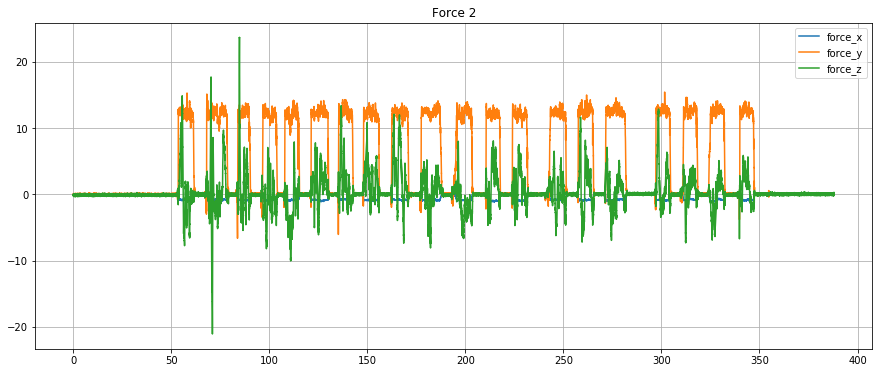

In [176]:
df = rft2_df
torque2_x = df.torque.apply(lambda x: x[0])
torque2_y = df.torque.apply(lambda x: x[1])
torque2_z = df.torque.apply(lambda x: x[2])

rft2_t_vec = df.time_stamp-t0

plt.figure(figsize=(15,6))
plt.plot(rft2_t_vec, torque2_x)
plt.plot(rft2_t_vec, torque2_y)
plt.plot(rft2_t_vec, torque2_z)
plt.grid()
plt.legend(['force_x', 'force_y', 'force_z'])
plt.title('Force 2')

## Position Data

### grf

##### Camera 1

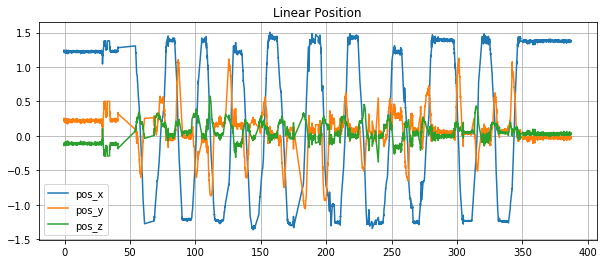

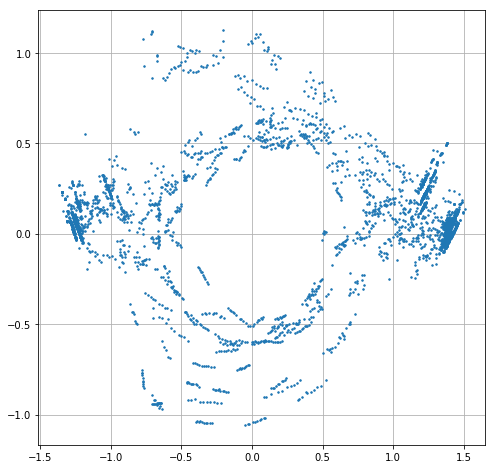

In [177]:
# Online
df = grf1_df
grf1_x = df.position.apply(lambda x: x[0])
grf1_y = df.position.apply(lambda x: x[1])
grf1_z = df.position.apply(lambda x: x[2])

grf1_t_vec = df.time_stamp-t0

plt.figure(figsize=(10,4))
plt.plot(grf1_t_vec, grf1_x)
plt.plot(grf1_t_vec, grf1_y)
plt.plot(grf1_t_vec, grf1_z)
plt.grid()
plt.legend(['pos_x', 'pos_y', 'pos_z'])
plt.title('Linear Position')

plt.figure(figsize=(8,8))
plt.plot(grf1_x, grf1_y,'.', MarkerSize=3)
plt.grid()

In [178]:
a = np.array([1,2,3])
np.isnan(a)

array([False, False, False])

Text(0.5,1,'Linear Position')

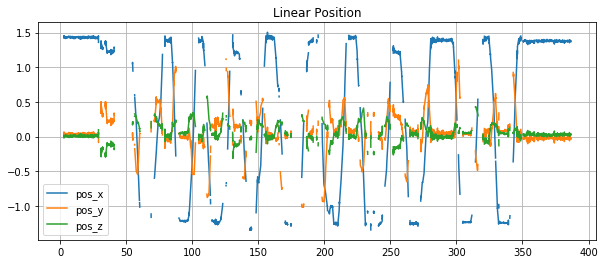

In [179]:
# Offline
df = grf1_off_df
grf1_x = df.position.apply(lambda x: x[0] if not np.isnan(x).all() else np.nan)
grf1_y = df.position.apply(lambda x: x[1] if not np.isnan(x).all() else np.nan)
grf1_z = df.position.apply(lambda x: x[2] if not np.isnan(x).all() else np.nan)

grf1_t_vec = df.time_stamp-t0

plt.figure(figsize=(10,4))
plt.plot(grf1_t_vec, grf1_x)
plt.plot(grf1_t_vec, grf1_y)
plt.plot(grf1_t_vec, grf1_z)
plt.grid()
plt.legend(['pos_x', 'pos_y', 'pos_z'])
plt.title('Linear Position')

##### Camera 2

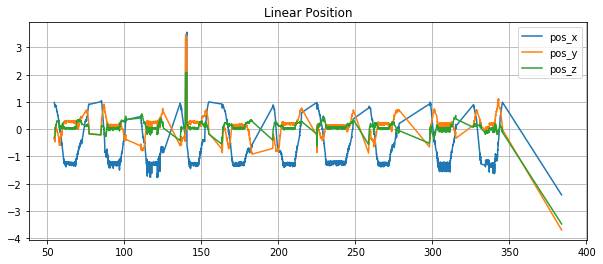

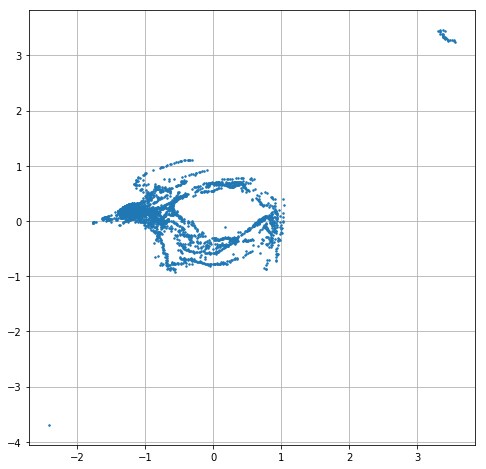

In [180]:
df = grf2_df
grf2_x = df.position.apply(lambda x: x[0])
grf2_y = df.position.apply(lambda x: x[1])
grf2_z = df.position.apply(lambda x: x[2])

grf2_t_vec = df.time_stamp-t0

plt.figure(figsize=(10,4))
plt.plot(grf2_t_vec, grf2_x)
plt.plot(grf2_t_vec, grf2_y)
plt.plot(grf2_t_vec, grf2_z)
plt.grid()
plt.legend(['pos_x', 'pos_y', 'pos_z'])
plt.title('Linear Position')


plt.figure(figsize=(8,8))
plt.plot(grf2_x, grf2_y,'.', MarkerSize=3)
plt.grid()

Text(0.5,1,'Linear Position')

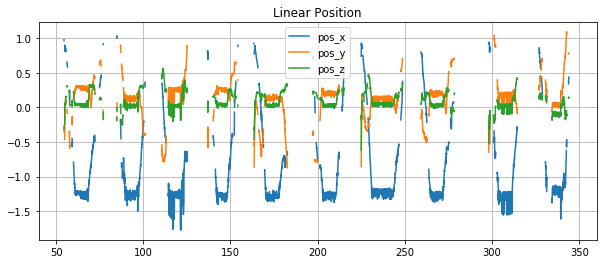

In [181]:
# Offline
df = grf2_off_df
grf2_off_x = df.position.apply(lambda x: x[0] if not np.isnan(x).all() else np.nan)
grf2_off_y = df.position.apply(lambda x: x[1] if not np.isnan(x).all() else np.nan)
grf2_off_z = df.position.apply(lambda x: x[2] if not np.isnan(x).all() else np.nan)

grf2_off_t_vec = df.time_stamp-t0

plt.figure(figsize=(10,4))
plt.plot(grf2_off_t_vec, grf2_off_x)
plt.plot(grf2_off_t_vec, grf2_off_y)
plt.plot(grf2_off_t_vec, grf2_off_z)
plt.grid()
plt.legend(['pos_x', 'pos_y', 'pos_z'])
plt.title('Linear Position')


# plt.figure(figsize=(8,8))
# plt.plot(grf2_off_x, grf2_off_y,'.', MarkerSize=3)
# plt.grid()

##### Camera 3

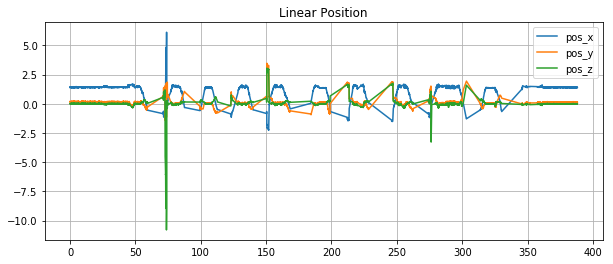

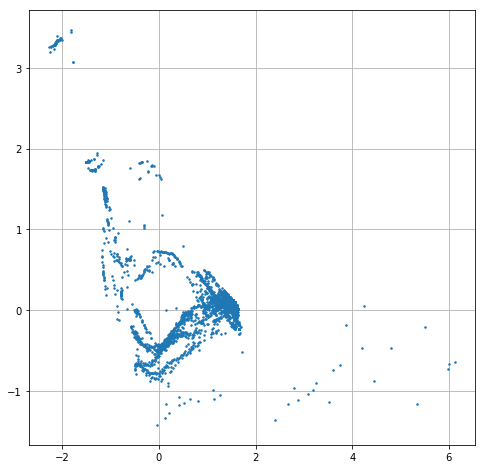

In [182]:
df = grf3_df
grf3_x = df.position.apply(lambda x: x[0])
grf3_y = df.position.apply(lambda x: x[1])
grf3_z = df.position.apply(lambda x: x[2])

grf3_t_vec = df.time_stamp-t0

plt.figure(figsize=(10,4))

plt.plot(grf3_t_vec, grf3_x)
plt.plot(grf3_t_vec, grf3_y)
plt.plot(grf3_t_vec, grf3_z)
plt.grid()
plt.legend(['pos_x', 'pos_y', 'pos_z'])
plt.title('Linear Position')

plt.figure(figsize=(8,8))
plt.plot(grf3_x, grf3_y,'.', MarkerSize=3)
plt.grid()

Text(0.5,1,'Linear Position')

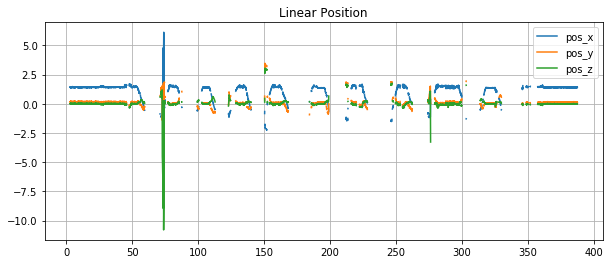

In [183]:
# Offline
df = grf3_off_df
grf1_x = df.position.apply(lambda x: x[0] if not np.isnan(x).all() else np.nan)
grf1_y = df.position.apply(lambda x: x[1] if not np.isnan(x).all() else np.nan)
grf1_z = df.position.apply(lambda x: x[2] if not np.isnan(x).all() else np.nan)

grf1_t_vec = df.time_stamp-t0

plt.figure(figsize=(10,4))
plt.plot(grf1_t_vec, grf1_x)
plt.plot(grf1_t_vec, grf1_y)
plt.plot(grf1_t_vec, grf1_z)
plt.grid()
plt.legend(['pos_x', 'pos_y', 'pos_z'])
plt.title('Linear Position')

### Raw Pose Data

Text(0.5,1,'Linear Position')

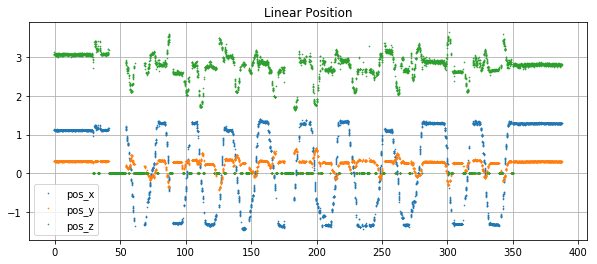

In [184]:
df = pose1_df
pose1_x = df.position.apply(lambda x: x[0])
pose1_y = df.position.apply(lambda x: x[1])
pose1_z = df.position.apply(lambda x: x[2])

pose1_t_vec = df.time_stamp-t0

plt.figure(figsize=(10,4))
plt.plot(pose1_t_vec, pose1_x, '.', MarkerSize=1.2)
plt.plot(pose1_t_vec, pose1_y, '.', MarkerSize=1.2)
plt.plot(pose1_t_vec, pose1_z, '.', MarkerSize=1.2)
plt.grid()
plt.legend(['pos_x', 'pos_y', 'pos_z'])
plt.title('Linear Position')

Text(0.5,1,'Linear Position')

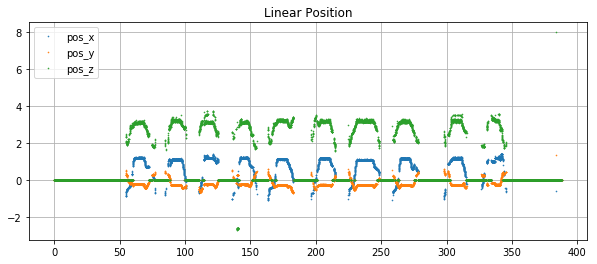

In [185]:
df = pose2_df
pose2_x = df.position.apply(lambda x: x[0])
pose2_y = df.position.apply(lambda x: x[1])
pose2_z = df.position.apply(lambda x: x[2])

pose2_t_vec = df.time_stamp-t0

plt.figure(figsize=(10,4))
plt.plot(pose2_t_vec, pose2_x, '.', MarkerSize=1.2)
plt.plot(pose2_t_vec, pose2_y, '.', MarkerSize=1.2)
plt.plot(pose2_t_vec, pose2_z, '.', MarkerSize=1.2)
plt.grid()
plt.legend(['pos_x', 'pos_y', 'pos_z'])
plt.title('Linear Position')

Text(0.5,1,'Linear Position')

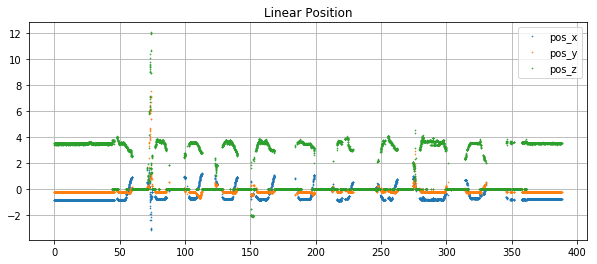

In [186]:
df = pose3_df
pose3_x = df.position.apply(lambda x: x[0])
pose3_y = df.position.apply(lambda x: x[1])
pose3_z = df.position.apply(lambda x: x[2])

pose3_t_vec = df.time_stamp-t0

plt.figure(figsize=(10,4))
plt.plot(pose3_t_vec, pose3_x, '.', MarkerSize=1.2)
plt.plot(pose3_t_vec, pose3_y, '.', MarkerSize=1.2)
plt.plot(pose3_t_vec, pose3_z, '.', MarkerSize=1.2)
plt.grid()
plt.legend(['pos_x', 'pos_y', 'pos_z'])
plt.title('Linear Position')

### IMU Data

In [187]:
imu_df.head()

,seq,time_stamp,frame_id,accel,gyro,mag
0,174267,1.602469e+09,LSM9DS1_IMU_SENSOR_DATA,"[-0.029916381835937502, -0.16095013427734375, ...","[-0.10467529296875, 1.742095947265625, -0.0448...","[0.051660001277923584, 0.3103800117969513, -0...."
1,174268,1.602469e+09,LSM9DS1_IMU_SENSOR_DATA,"[-0.062226074218750003, -0.1376153564453125, 9...","[0.01495361328125, -0.0897216796875, 0.0]","[0.050680000334978104, 0.3109399974346161, -0...."
2,174269,1.602469e+09,LSM9DS1_IMU_SENSOR_DATA,"[-0.04248126220703125, -0.13641870117187502, 9...","[-0.0299072265625, 0.142059326171875, -0.15701...","[0.052080001682043076, 0.3155600130558014, -0...."
3,174270,1.602469e+09,LSM9DS1_IMU_SENSOR_DATA,"[0.0095732421875, -0.12684545898437502, 9.7323...","[-0.01495361328125, -0.022430419921875, -0.119...","[0.05138000100851059, 0.3116399943828583, -0.3..."
4,174271,1.602469e+09,LSM9DS1_IMU_SENSOR_DATA,"[-0.02213812255859375, -0.12086218261718751, 9...","[-0.127105712890625, -0.067291259765625, -0.05...","[0.05152000114321709, 0.3110800087451935, -0.3..."


In [188]:
df.time_stamp[0]

1602469147.288075

Text(0.5,1,'Acceleration')

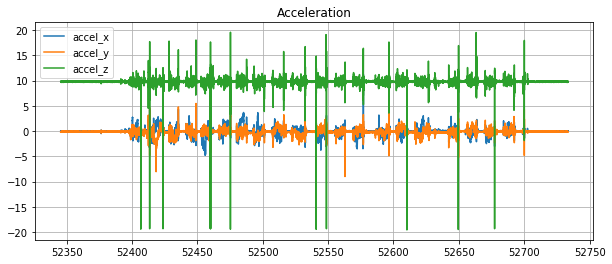

In [189]:
df = imu_df
accel_x = df.accel.apply(lambda x: x[0])
accel_y = df.accel.apply(lambda x: x[1])
accel_z = df.accel.apply(lambda x: x[2])

imu_t_vec = df.time_stamp-t0 + imu_delay

plt.figure(figsize=(10,4))
plt.plot(imu_t_vec, accel_x)
plt.plot(imu_t_vec, accel_y)
plt.plot(imu_t_vec, accel_z)
plt.grid()
plt.legend(['accel_x', 'accel_y', 'accel_z'])
plt.title('Acceleration')

### Mix Plot

Text(0.5,0,'time, sec')

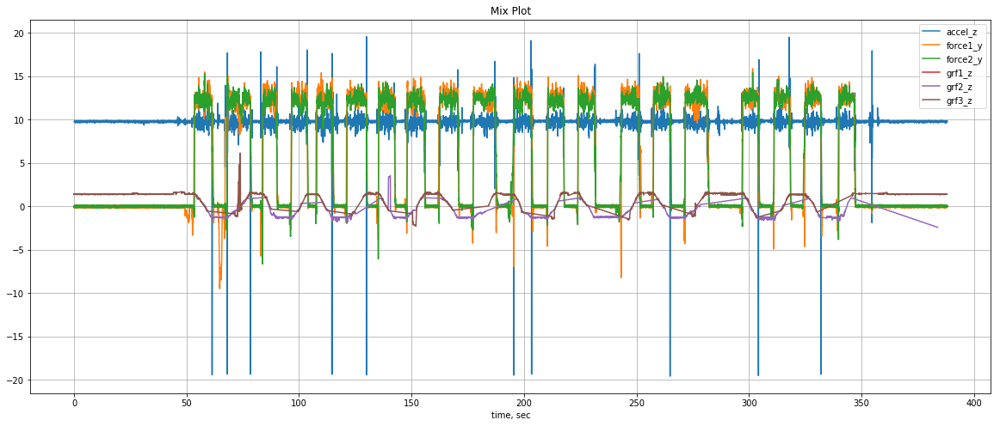

In [190]:
plt.figure(figsize=(20,8))

plt.plot(imu_t_vec-imu_delay, accel_z)
plt.plot(rft1_t_vec, force1_y)
plt.plot(rft2_t_vec, force2_y)
plt.plot(grf1_t_vec, grf1_x)
plt.plot(grf2_t_vec, grf2_x)
plt.plot(grf3_t_vec, grf3_x)
plt.grid()
plt.legend(['accel_z', 'force1_y', 'force2_y', 'grf1_z', 'grf2_z', 'grf3_z'])
plt.title('Mix Plot')
plt.xlabel('time, sec')

In [191]:
# plt.plot(rft1_t_vec, force1_y)

layout = go.Layout(
    title='Annotation',
    xaxis = dict(title='time, secs'),
    yaxis = dict(title='signal magnetude')
)

trace1 = go.Scatter(x = rft1_t_vec, y=force1_y)

fig = go.Figure(data=[trace1], layout=layout)
py.offline.iplot(fig)